In [1]:
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

import scipy
from hampel import hampel

import datetime as dt

In [2]:
df = pd.read_excel("Amruth_Bedroom_Analysis.xlsx", usecols="A:F,H")
df.head()

,Sl Number,Date and Time,mG,V/m,mW/m2,µW/m2,Possible Source
0,1,2023-01-06 19:57:00,1.0,0.0,0.026,26.0,Mixed
1,2,2023-01-06 19:57:01,1.0,0.0,0.026,26.0,Mixed
2,3,2023-01-06 19:57:02,1.0,0.0,0.026,26.0,Mixed
3,4,2023-01-06 19:57:03,1.0,0.0,0.026,26.0,Mixed
4,5,2023-01-06 19:57:04,1.0,0.0,0.003,3.0,Mixed


### Data check and cleaning

#### Check and set

In [3]:
df.isnull().any()

Sl Number           False
Date and Time       False
mG                  False
V/m                 False
mW/m2               False
µW/m2               False
 Possible Source    False
dtype: bool

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62127 entries, 0 to 62126
Data columns (total 7 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   Sl Number         62127 non-null  int64         
 1   Date and Time     62127 non-null  datetime64[ns]
 2   mG                62127 non-null  float64       
 3   V/m               62127 non-null  float64       
 4   mW/m2             62127 non-null  float64       
 5   µW/m2             62127 non-null  float64       
 6    Possible Source  62127 non-null  object        
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 3.3+ MB


In [5]:
df.columns = ["index", "datetime", "mG", "V/m", "mW/m2", "microW/m2", "source"]
df["source"][:10]

0    Mixed
1    Mixed
2    Mixed
3    Mixed
4    Mixed
5    Mixed
6    Mixed
7    Mixed
8    Mixed
9    Mixed
Name: source, dtype: object

In [6]:
df["source"].unique()
# To be converted into categorical

array(['Mixed', 'WiFi/Phone', 'Power Line', 'Cell Tower', 'Static'],
      dtype=object)

In [7]:
df["source"] = pd.Categorical(df["source"])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62127 entries, 0 to 62126
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   index      62127 non-null  int64         
 1   datetime   62127 non-null  datetime64[ns]
 2   mG         62127 non-null  float64       
 3   V/m        62127 non-null  float64       
 4   mW/m2      62127 non-null  float64       
 5   microW/m2  62127 non-null  float64       
 6   source     62127 non-null  category      
dtypes: category(1), datetime64[ns](1), float64(4), int64(1)
memory usage: 2.9 MB


In [8]:
df["source"].value_counts()

Mixed         45520
WiFi/Phone    15676
Cell Tower      918
Power Line       11
Static            2
Name: source, dtype: int64

#### Raw Visual Analaysis

In [9]:
sns.set_style("whitegrid")
sns.set_palette("winter")

<AxesSubplot:xlabel='datetime', ylabel='microW/m2'>

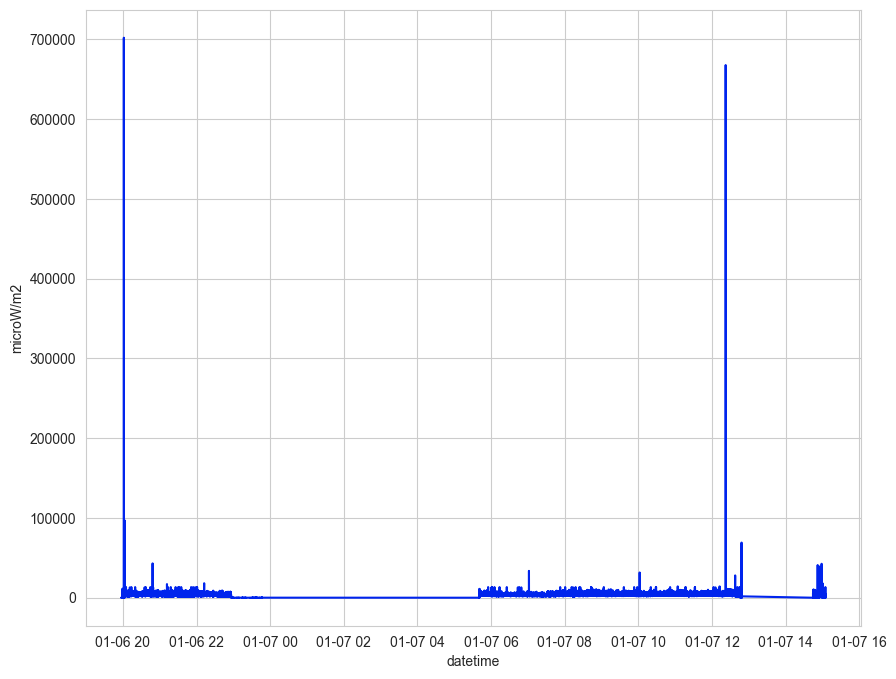

In [10]:
plt.figure(figsize=(10, 8))
sns.lineplot(x=df["datetime"], y=df["microW/m2"])

#### Differentiation

Adding meaning to plots with sleep human activity

In [51]:
import plotly.graph_objects as go

fig = go.Figure()
sleep = dt.datetime(2023, 1, 6, 23)
awake = dt.datetime(2023, 1, 7, 5, 40)

fig.add_scatter(
    x = df["datetime"],
    y = df["microW/m2"],
    opacity=0.8,
)
fig.add_vline(
    x = sleep.timestamp() * 1000,
    line_dash = "dot",
    line_color = "black",
    annotation_text = "11:00 pm",
    annotation_position = "top right",
    annotation_font_color = "white"
)
fig.add_vline(
    x = awake.timestamp() * 1000,
    line_dash = "dot",
    line_color = "black",
    annotation_text = "5:30 am",
    annotation_position = "top left",
    annotation_font_color = "white"
)
fig.add_vrect(
    x0=sleep.timestamp() * 1000,
    x1=awake.timestamp() * 1000,
    fillcolor = "black",
    opacity=0.33
)
fig.update_layout(
    title="EMF Radiation over a day",
    xaxis_title = "Time",
    yaxis_title="EMF Radiation (μW/m2)"
)

In [107]:
sleep_df = df[(df["datetime"] > sleep) & (df["datetime"] < awake)]

fig = px.scatter(
    sleep_df,
    x="datetime",
    y="microW/m2",
    opacity=0.5,
    trendline="rolling",
    trendline_color_override="blue",
    trendline_options=dict(window=600)
    )

fig.update_layout(
    title="EMF Radiation during night hours (11:00 pm - 5:30 am)",
    xaxis_title = "Time",
    yaxis_title="EMF Radiation (μW/m2)"
)
fig.update_traces(
    marker=dict(color="darkgrey")
)

### Density graphs

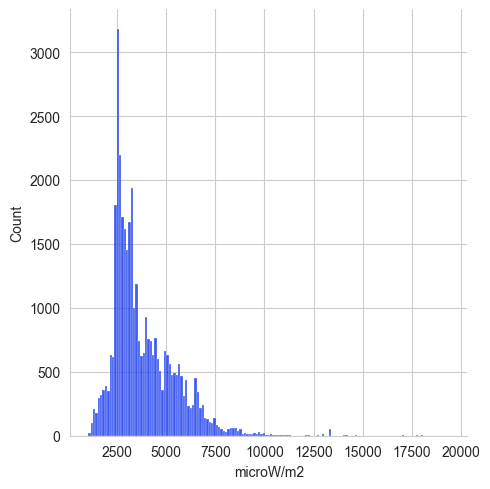

In [13]:
sns.displot(df[(df["microW/m2"] < 20000) & (df["microW/m2"] > 1000)]["microW/m2"])

Heavy right skewed distribution. A huge number of points falling between 0-1000 range that can skew the distribution further.

In [109]:
sleep_df.head()

,index,datetime,mG,V/m,mW/m2,microW/m2,source,outliers,MA30,MA60,MA90
11018,11019,2023-01-06 23:00:01,0.7,0.0,0.015,15.0,Mixed,False,35.933333,40.100000,35.111111
11019,11020,2023-01-06 23:00:02,0.7,0.6,0.051,51.0,Mixed,False,36.533333,40.716667,35.422222
11020,11021,2023-01-06 23:00:03,0.7,0.0,0.017,17.0,Mixed,False,36.200000,40.300000,35.422222
11021,11022,2023-01-06 23:00:04,0.7,0.0,0.009,9.0,Mixed,False,35.000000,39.533333,35.400000
11022,11023,2023-01-06 23:00:05,0.7,0.0,0.014,14.0,Mixed,False,35.066667,37.716667,35.300000


In [111]:
awake_df = df[(df["datetime"] < sleep) | (df["datetime"] > awake)]
awake_df.head()

,index,datetime,mG,V/m,mW/m2,microW/m2,source,outliers,MA30,MA60,MA90
0,1,2023-01-06 19:57:00,1.0,0.0,0.026,26.0,Mixed,False,NaN,NaN,NaN
1,2,2023-01-06 19:57:01,1.0,0.0,0.026,26.0,Mixed,False,NaN,NaN,NaN
2,3,2023-01-06 19:57:02,1.0,0.0,0.026,26.0,Mixed,False,NaN,NaN,NaN
3,4,2023-01-06 19:57:03,1.0,0.0,0.026,26.0,Mixed,False,NaN,NaN,NaN
4,5,2023-01-06 19:57:04,1.0,0.0,0.003,3.0,Mixed,False,NaN,NaN,NaN


In [127]:
from plotly.subplots import make_subplots

fig = make_subplots(
    rows=1,
    cols=2,
    subplot_titles=("EMR Count during active hours", "EMR Count during sleep hours")
    )

fig.add_trace(
    go.Histogram(
        x = awake_df[(awake_df["microW/m2"] < 20000) & (awake_df["microW/m2"] > 1000)]["microW/m2"],
        nbinsx=200,
        opacity=0.6,
        marker_color="blue"
    ),
    row=1,
    col=1
)

fig.add_vline(
    x = 1000,
    line_dash = "dot",
    line_color = "red",
    opacity = 0.4,
    annotation_text = "Safe level",
    annotation_position = "top right",
    annotation_font_color = "red",
    annotation_opacity= 0.6
)

fig.add_trace(
    go.Histogram(
        x = sleep_df["microW/m2"],
        nbinsx=200,
        marker_color="darkgrey",
    ),
    row=1,
    col=2
)

fig.update_layout(
    showlegend=False,
    title_text="EMR count throughout the day",
    )

fig.update_xaxes(title_text="EMF Radiation (μW/m2)", row=1, col=1)
fig.update_xaxes(title_text="EMF Radiation (μW/m2)", row=1, col=2)
fig.update_yaxes(title_text="Count", row=1, col=1)
fig.update_yaxes(title_text="Count", row=1, col=2)

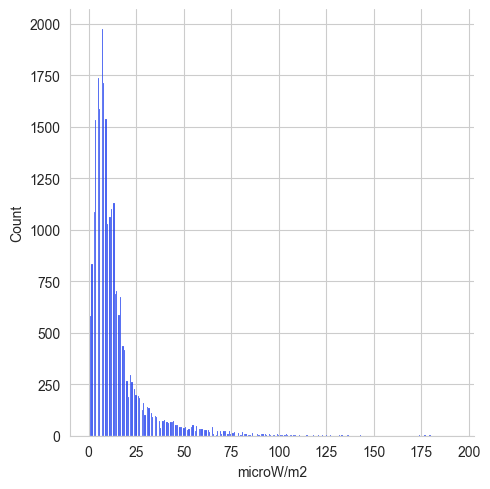

In [14]:
sns.displot(df[(df["microW/m2"] < 200)]["microW/m2"])

### Outliers

#### Raw Numbers

In [10]:
avg = df["microW/m2"].mean()
std = df["microW/m2"].std()

print("Mean: ", avg)
print("Std Dev: ", std)

print((avg + (2 * std)), (avg - (2 * std)))

Mean:  2379.215687221337
Std Dev:  6636.84170965988
15652.899106541096 -10894.467732098423


In [11]:
outliers = df[df["microW/m2"] > 16000]
outliers.count()

index        49
datetime     49
mG           49
V/m          49
mW/m2        49
microW/m2    49
source       49
dtype: int64

#### Outlier specific graphs

6th Night, Jan 2023 between 8:00 pm to 8:03 pm

In [140]:
from scipy.interpolate import make_interp_spline
from matplotlib.dates import DateFormatter

fig = go.Figure()
before830 = outliers[outliers["datetime"] < dt.datetime(2023, 1, 6, 20, 30)]

idx = range(len(before830))
xnew = np.linspace(min(idx), max(idx), 300)
# spline
spl = make_interp_spline(idx, before830["microW/m2"], k=3)
smooth = spl(xnew)

fig.add_scatter(
    x = xnew,
    y = smooth,
    opacity = 0.5,
)

fig.update_layout(
    title="EMR b/w 8:01 pm - 8:03 pm",
    xaxis_tickformat = "%h %m %s",
    xaxis = dict(
        tickmode= "array",
        tickvals = before830["datetime"][::3],
        ticktext = before830["datetime"][::3]
    )
)




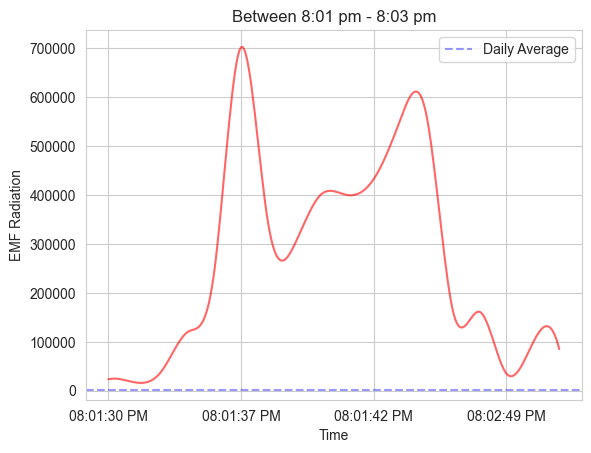

In [148]:
from scipy.interpolate import make_interp_spline
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots()

before830 = outliers[outliers["datetime"] < dt.datetime(2023, 1, 6, 20, 30)]

idx = range(len(before830))
xnew = np.linspace(min(idx), max(idx), 300)

spl = make_interp_spline(idx, before830["microW/m2"], k=3)
smooth = spl(xnew)


sns.lineplot(x = xnew, y = smooth, alpha=0.6, color='r')

plt.axhline(y = avg, color="blue", alpha=0.4, linestyle="--", label="Daily Average")

plt.xticks(idx[::5], before830["datetime"].dt.strftime("%I:%M:%S %p")[::5])

plt.xlabel("Time")
plt.ylabel("EMF Radiation")
plt.title("Between 8:01 pm - 8:03 pm")
plt.legend()

plt.show()

c:\Users\jaypr\vsc\radiation testing\virtual\lib\site-packages\ipykernel_launcher.py:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


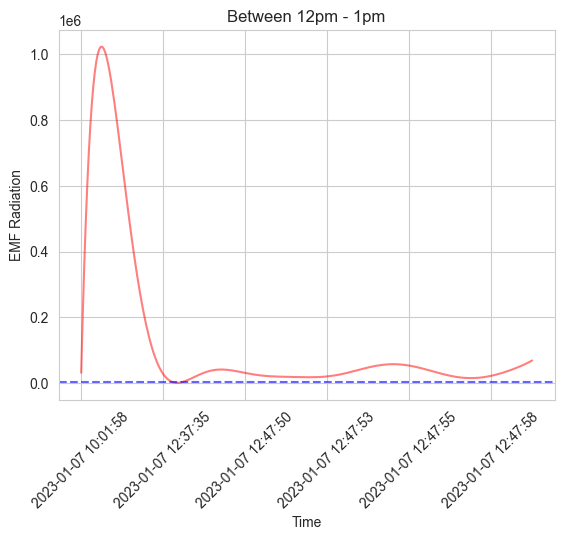

In [13]:
from scipy.interpolate import make_interp_spline
from matplotlib.dates import DateFormatter

after9 = outliers[outliers["datetime"] > dt.datetime(2023, 1, 7, 9)]

fig, ax = plt.subplots()

after12 = after9[outliers["datetime"] > dt.datetime(2023, 1, 7, 12)]
after12 = after9[after9["datetime"] < dt.datetime(2023, 1, 7, 13)]

idx = range(len(after12))
xnew = np.linspace(min(idx), max(idx), 300)

spl = make_interp_spline(idx, after12["microW/m2"], k=7)
smooth = spl(xnew)

dfmt = DateFormatter("%H:%M:%S")
ax.xaxis.set_major_formatter(dfmt)

sns.lineplot(x = xnew, y = smooth, alpha=0.5, color='r')

plt.axhline(y = avg, color="blue", alpha=0.6, linestyle="--", label="Daily Average")

plt.xticks(idx[::2], after12["datetime"][::2], rotation=45)
plt.xlabel("Time")
plt.ylabel("EMF Radiation")
plt.title("Between 12pm - 1pm")

plt.show()

<AxesSubplot:xlabel='datetime', ylabel='microW/m2'>

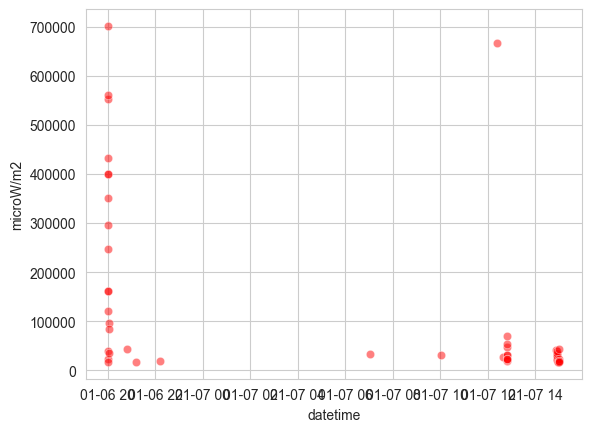

In [21]:
sns.scatterplot(data=outliers, x="datetime", y="microW/m2", alpha=0.5, color="r")

### Plotly Graphs

In [14]:
df["outliers"] = df["microW/m2"] > (avg + (2 * std))
df.head()

,index,datetime,mG,V/m,mW/m2,microW/m2,source,outliers
0,1,2023-01-06 19:57:00,1.0,0.0,0.026,26.0,Mixed,False
1,2,2023-01-06 19:57:01,1.0,0.0,0.026,26.0,Mixed,False
2,3,2023-01-06 19:57:02,1.0,0.0,0.026,26.0,Mixed,False
3,4,2023-01-06 19:57:03,1.0,0.0,0.026,26.0,Mixed,False
4,5,2023-01-06 19:57:04,1.0,0.0,0.003,3.0,Mixed,False


In [149]:
above0_avg = df[df["microW/m2"] > 0]["microW/m2"].mean()

# Initial raw graph with outlier points highlighted, overall average value and allowed limit

fig = px.scatter(data_frame=df, x="datetime", y="microW/m2", color="outliers", opacity=0.5)

# Add day average
fig.add_shape(
    type="line",

    x0 = df["datetime"].iloc[0],
    x1 = df["datetime"].iloc[-1],

    y0 = above0_avg,
    y1 = above0_avg,

    line = dict(color="Black"),
    xref="x",
    yref="y",

    opacity=0.5
)

fig.add_shape(
    type="line",

    x0 = df["datetime"].iloc[0],
    x1 = df["datetime"].iloc[-1],

    y0 = 1000,
    y1 = 1000,

    line = dict(color="Green"),
    xref="x",
    yref="y",

    opacity=0.6
)

fig.show()

In [16]:
inline = df[df["microW/m2"] < (avg + (2*std))].copy()

fig = px.scatter(data_frame=inline, x="datetime", y="microW/m2", opacity=0.2)
# Add day average
fig.add_hline(
    y=above0_avg,
    line_dash = "dash",
    annotation_text="Average EMF Radiation",
    annotation_position = "top left"
)

fig.add_hline(
    y = 1000,
    line_dash = "dot",
    line_color = "limegreen",
    annotation_text = "Safe level",
    annotation_position = "top left",
    annotation_font_color = "limegreen"
)

fig.update_layout(
    title="EMF Radiation Points",
    xaxis_title = "Time",
    yaxis_title="EMF Radiation (μW/m2)"
)

fig.show()

In [17]:
#inline = df[df["microW/m2"] < (avg + (2*std))]
above10k = df[df["microW/m2"] > 10000]

fig = px.scatter(data_frame=above10k, x="datetime", y="microW/m2", opacity=0.4, color_discrete_sequence=["red"])

# Add day average
fig.add_shape(
    type="line",

    x0 = above10k["datetime"].iloc[0],
    x1 = above10k["datetime"].iloc[-1],

    y0 = above0_avg,
    y1 = above0_avg,

    line = dict(color="Black"),
    xref="x",
    yref="y",

    opacity=0.5,
)

fig.add_shape(
    type="line",

    x0 = above10k["datetime"].iloc[0],
    x1 = above10k["datetime"].iloc[-1],

    y0 = 1000,
    y1 = 1000,

    line = dict(color="Green"),
    xref="x",
    yref="y",

    opacity=0.6,
)


fig.show()

#### Moving Averages

On the full data

In [18]:
# Moving average graph
df["MA30"] = df["microW/m2"].rolling(30).mean()
df["MA60"] = df["microW/m2"].rolling(60).mean()
df["MA90"] = df["microW/m2"].rolling(90).mean()
#inline["MA30"] = inline["microW/m2"].rolling(30).mean()

In [19]:
# 30, 60, 90 second intervals
fig = px.line(data_frame=df, x="datetime", y="microW/m2")
fig.add_scatter(
    x=df["datetime"],
    y=df["MA30"],
    name="Moving Average: 30 secs"
    )
fig.add_scatter(
    x=df["datetime"],
    y=df["MA60"],
    name="Moving Average: 60 secs"
    )
fig.add_scatter(
    x=df["datetime"],
    y=df["MA90"],
    name="Moving Average: 90 secs"
)


#px.line(data_frame=df, x="datetime", y="MA60")

In [28]:
# 30, 60, 90 second intervals
import plotly.graph_objects as go

fig = go.Figure()
fig.add_scatter(
    x=df["datetime"],
    y=df["MA30"],
    name="Moving Average: 30 secs"
    )
fig.add_scatter(
    x=df["datetime"],
    y=df["MA60"],
    name="Moving Average: 60 secs"
    )
fig.add_scatter(
    x=df["datetime"],
    y=df["MA90"],
    name="Moving Average: 90 secs"
)


#px.line(data_frame=df, x="datetime", y="MA60")

Moving Averages of non-outliers only

In [ ]:
# Moving average graph
inline["MA60"] = inline["microW/m2"].rolling(60).mean()
inline["MA180"] = inline["microW/m2"].rolling(180).mean()
inline["MA300"] = inline["microW/m2"].rolling(300).mean()

In [35]:
# 30, 60, 90 second intervals
import plotly.graph_objects as go
import plotly.offline as py

fig = go.Figure()
fig.add_scatter(
    x=inline["datetime"].iloc[::10],
    y=inline["MA60"].iloc[::10],
    name="Moving Average: 1 min",
    mode = "lines+markers"
    )
fig.add_scatter(
    x=inline["datetime"].iloc[::10],
    y=inline["MA180"].iloc[::10],
    name="Moving Average: 3 mins",
    mode="lines+markers"
    )
fig.add_scatter(
    x=inline["datetime"].iloc[::10],
    y=inline["MA300"].iloc[::10],
    name="Moving Average: 5 mins",
    mode="lines+markers"
)

"""fig.add_hrect(
    y0=1000,
    y1=10000,
    fillcolor="red",
    opacity=0.15
)"""

fig.update_layout(
    title="Moving Average of EMF Radiation over a day",
    xaxis_title = "Time",
    yaxis_title="EMF Radiation (μW/m2)"
)

fig.update_traces(
    marker=dict(
        size=2,
    )
)

fig.add_hline(
    y = 1000,
    line_dash = "dot",
    line_color = "limegreen",
    annotation_text = "Safe level",
    annotation_position = "top left",
    annotation_font_color = "limegreen"
)

figw = go.FigureWidget(fig)
scatter = figw.data[0]

def selection_fn(trace, points, selector):
    print(points.point_inds)

scatter.on_selection(selection_fn)

figw.show()

### Seasonality/Trend Analysis

In [107]:
trend = inline[(inline["datetime"] > dt.datetime(2023, 1, 7, 5, 45)) & (inline["datetime"] < dt.datetime(2023, 1, 7, 12, 30))]
trend.head()

,index,datetime,mG,V/m,mW/m2,microW/m2,source,outliers,MA30,MA60,MA90
35400,35401,2023-01-07 05:45:01,0.7,0.0,3.449,3449.0,Mixed,False,3474.533333,3563.500000,3580.288889
35401,35402,2023-01-07 05:45:02,0.6,0.0,3.293,3293.0,WiFi/Phone,False,3476.200000,3536.416667,3577.355556
35402,35403,2023-01-07 05:45:03,0.6,0.0,3.503,3503.0,Mixed,False,3490.566667,3522.350000,3591.211111
35403,35404,2023-01-07 05:45:04,0.6,0.0,3.530,3530.0,Mixed,False,3467.733333,3517.633333,3590.600000
35404,35405,2023-01-07 05:45:05,0.6,0.0,3.503,3503.0,WiFi/Phone,False,3446.133333,3523.200000,3599.588889


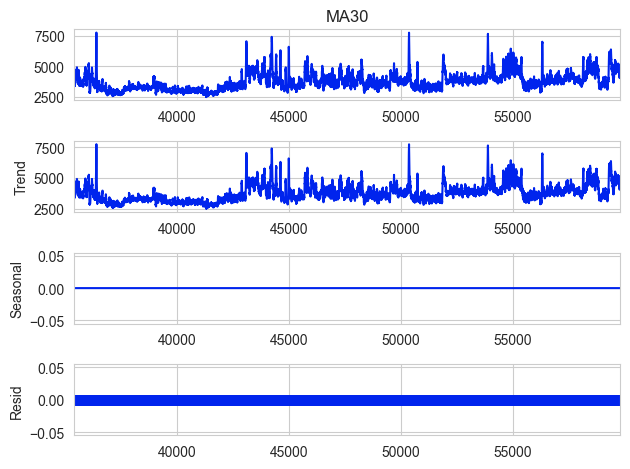

In [118]:
from statsmodels.tsa.seasonal import seasonal_decompose
from matplotlib import pyplot

result_a = seasonal_decompose(trend["MA30"], model="additive", period=1)
result_a.plot()
pyplot.show()

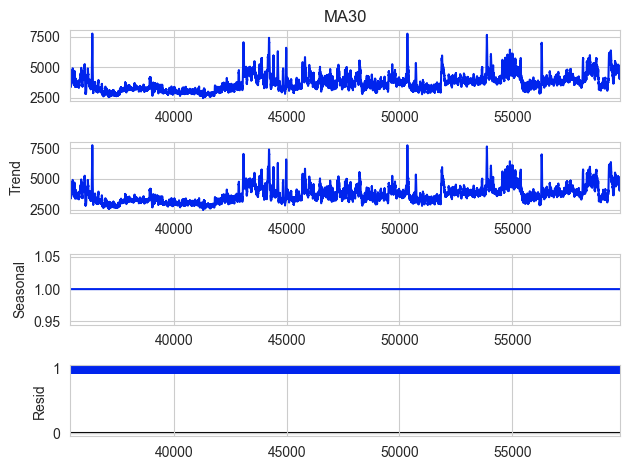

In [119]:
result_m = seasonal_decompose(trend["MA30"], model="multiplicative", period=1)
result_m.plot()
pyplot.show()